In [1]:
import pandas as pd
import folium
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt

In [2]:
stopandsearchdf = pd.read_parquet('stopandsearch.paraquet')

In [3]:
stopandsearchdf

,Type,Date,Part of a policing operation,Policing operation,Latitude,Longitude,Gender,Age range,Self-defined ethnicity,Officer-defined ethnicity,Object of search,Outcome,Outcome linked to object of search,Removal of more than just outer clothing
178930,Person search,2016-05-31T23:01:00+00:00,0.0,NaN,51.455989,-0.043536,Male,10-17,Black or Black British - African (B2),Black,Controlled drugs,Nothing found - no further action,NaN,NaN
178931,Person and Vehicle search,2016-05-31T23:05:00+00:00,0.0,NaN,51.475561,-0.075330,Male,None,Not Stated (NS),Black,Controlled drugs,Nothing found - no further action,NaN,NaN
178932,Person search,2016-05-31T23:07:00+00:00,0.0,NaN,51.533030,-0.203277,Male,18-24,Black or Black British - Caribbean (B1),Black,Articles for use in criminal damage,Nothing found - no further action,NaN,NaN
178933,Person search,2016-05-31T23:10:00+00:00,0.0,NaN,51.553184,-0.176043,Male,18-24,Not Stated (NS),White,Articles for use in criminal damage,Nothing found - no further action,NaN,NaN
178934,Person search,2016-05-31T23:10:00+00:00,0.0,NaN,51.553184,-0.176043,Female,18-24,White - Any other White ethnic background (W9),White,Articles for use in criminal damage,Nothing found - no further action,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1533191,Person search,2023-03-31T22:43:00+00:00,0.0,NaN,51.578389,0.180957,Male,over 34,Other ethnic group - Any other ethnic group,Asian,Offensive weapons,A no further action disposal,NaN,NaN
1533192,Person search,2023-03-31T22:44:00+00:00,0.0,NaN,51.516295,-0.129487,Male,25-34,Other ethnic group - Not stated,Black,Controlled drugs,A no further action disposal,NaN,NaN
1533193,Person search,2023-03-31T22:44:00+00:00,0.0,NaN,51.545724,-0.011334,Male,25-34,Black/African/Caribbean/Black British - African,Black,Controlled drugs,Community resolution,NaN,NaN
1533194,Person search,2023-03-31T22:48:00+00:00,0.0,NaN,51.528633,-0.125729,Female,25-34,White - English/Welsh/Scottish/Northern Irish/...,White,Controlled drugs,A no further action disposal,NaN,NaN


In [4]:
# Convert 'Date' column to datetime format
stopandsearchdf['Date'] = pd.to_datetime(stopandsearchdf['Date'])

# Extract year and month into new columns
stopandsearchdf['Year'] = stopandsearchdf['Date'].dt.year
stopandsearchdf['Month'] = stopandsearchdf['Date'].dt.month

# Remove the 'Date' column
stopandsearchdf = stopandsearchdf.drop('Date', axis=1)

stopandsearchdf

,Type,Part of a policing operation,Policing operation,Latitude,Longitude,Gender,Age range,Self-defined ethnicity,Officer-defined ethnicity,Object of search,Outcome,Outcome linked to object of search,Removal of more than just outer clothing,Year,Month
178930,Person search,0.0,NaN,51.455989,-0.043536,Male,10-17,Black or Black British - African (B2),Black,Controlled drugs,Nothing found - no further action,NaN,NaN,2016,5
178931,Person and Vehicle search,0.0,NaN,51.475561,-0.075330,Male,None,Not Stated (NS),Black,Controlled drugs,Nothing found - no further action,NaN,NaN,2016,5
178932,Person search,0.0,NaN,51.533030,-0.203277,Male,18-24,Black or Black British - Caribbean (B1),Black,Articles for use in criminal damage,Nothing found - no further action,NaN,NaN,2016,5
178933,Person search,0.0,NaN,51.553184,-0.176043,Male,18-24,Not Stated (NS),White,Articles for use in criminal damage,Nothing found - no further action,NaN,NaN,2016,5
178934,Person search,0.0,NaN,51.553184,-0.176043,Female,18-24,White - Any other White ethnic background (W9),White,Articles for use in criminal damage,Nothing found - no further action,NaN,NaN,2016,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1533191,Person search,0.0,NaN,51.578389,0.180957,Male,over 34,Other ethnic group - Any other ethnic group,Asian,Offensive weapons,A no further action disposal,NaN,NaN,2023,3
1533192,Person search,0.0,NaN,51.516295,-0.129487,Male,25-34,Other ethnic group - Not stated,Black,Controlled drugs,A no further action disposal,NaN,NaN,2023,3
1533193,Person search,0.0,NaN,51.545724,-0.011334,Male,25-34,Black/African/Caribbean/Black British - African,Black,Controlled drugs,Community resolution,NaN,NaN,2023,3
1533194,Person search,0.0,NaN,51.528633,-0.125729,Female,25-34,White - English/Welsh/Scottish/Northern Irish/...,White,Controlled drugs,A no further action disposal,NaN,NaN,2023,3


In [5]:
# Read the GeoJSON file
lsoa_data = gpd.read_file("london.geojson")

# Convert the coordinates in the stop and search data to Point objects
stopandsearchdf['geometry'] = [Point(xy) for xy in zip(stopandsearchdf['Longitude'], stopandsearchdf['Latitude'])]
stopandsearchdf = gpd.GeoDataFrame(stopandsearchdf, geometry='geometry')

# Perform the spatial join
stopandsearchdf_with_lsoa = gpd.sjoin(stopandsearchdf, lsoa_data, how='left', op='within')

# Extract the LSOA code from the joined data
stopandsearchdf_with_lsoa['LSOA_code'] = stopandsearchdf_with_lsoa['lsoa11cd']

# Save the result or use it for further analysis
stopandsearchdf_with_lsoa.to_csv("stopandsearch_with_lsoa.csv")


c:\Users\20211576\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\core\interactiveshell.py:3361: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if (await self.run_code(code, result,  async_=asy)):
C:\Users\20211576\AppData\Local\Temp/ipykernel_24148/2930732862.py:9: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326

  stopandsearchdf_with_lsoa = gpd.sjoin(stopandsearchdf, lsoa_data, how='left', op='within')


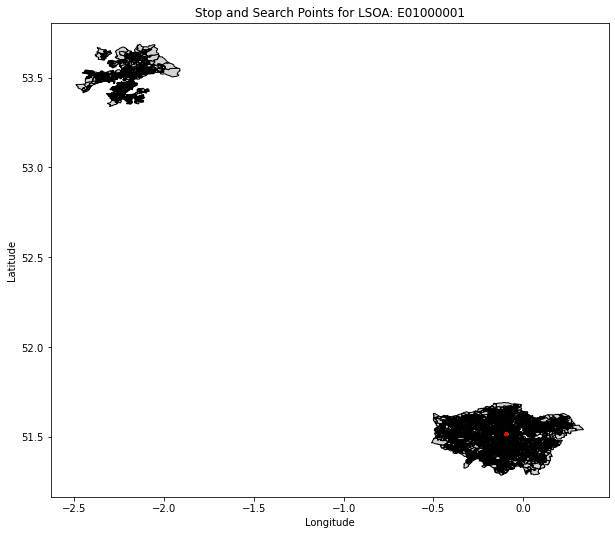

In [6]:
# Filter the data for the chosen LSOA code
chosen_lsoa = "E01000001"
filtered_data = stopandsearchdf_with_lsoa[stopandsearchdf_with_lsoa['LSOA_code'] == chosen_lsoa]

# Plot the stop and search points and the LSOA boundaries
fig, ax = plt.subplots(figsize=(10, 10))
lsoa_data.plot(ax=ax, color='lightgray', edgecolor='black')
filtered_data.plot(ax=ax, color='red', markersize=5)

# Set the plot title and labels
ax.set_title("Stop and Search Points for LSOA: {}".format(chosen_lsoa))
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

# Show the plot
plt.show()

In [7]:
# Choose the LSOA code to focus on
chosen_lsoa = "E01000001"

# Filter the data for the chosen LSOA code
filtered_data = stopandsearchdf_with_lsoa[stopandsearchdf_with_lsoa['LSOA_code'] == chosen_lsoa]

# Create a folium.Map object centered around the chosen LSOA's coordinates
map_center = filtered_data[['Latitude', 'Longitude']].mean().values.tolist()
m = folium.Map(location=map_center, zoom_start=13)

# Add a GeoJson layer to display the LSOA boundaries
lsoa_geojson = "london.geojson"
folium.GeoJson(lsoa_geojson).add_to(m)

# Add markers for the filtered stop and search points
for index, row in filtered_data.iterrows():
    folium.Marker([row['Latitude'], row['Longitude']]).add_to(m)

# Display the map
m


In [8]:
# Count the number of stop and search distributions for each LSOA
lsoa_counts = stopandsearchdf_with_lsoa['LSOA_code'].value_counts()

# Select the top 15 LSOAs with the highest distribution counts
top_lsoas = lsoa_counts.head(15)

top_lsoas

LSOA_code
E01004763    8946
E01004734    8526
E01001013    7735
E01004736    7562
E01000010    5380
E01000863    5102
E01003047    4176
E01000919    4165
E01004325    4117
E01000675    3910
E01002034    3821
E01003591    3568
E01003176    3567
E01004765    3486
E01003728    3468
Name: count, dtype: int64

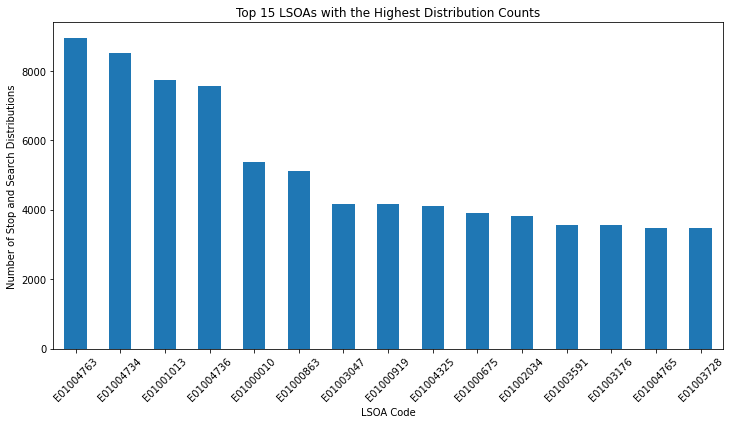

In [9]:
# Plot the top 15 LSOAs
plt.figure(figsize=(12, 6))
top_lsoas.plot(kind='bar')
plt.xlabel('LSOA Code')
plt.ylabel('Number of Stop and Search Distributions')
plt.title('Top 15 LSOAs with the Highest Distribution Counts')
plt.xticks(rotation=45)
plt.show()

In [10]:
# Convert the stop and search data to a DataFrame
stop_and_search_df = pd.DataFrame(stopandsearchdf_with_lsoa, columns=['LSOA_code'])

# Group the stop and search data by LSOA code and count the number of stop and searches in each area
stop_and_search_count = stop_and_search_df['LSOA_code'].value_counts().reset_index()
stop_and_search_count.columns = ['LSOA_code', 'Count']

# Read the GeoJSON file containing LSOA boundaries
geojson_file = 'London.geojson'
lsoa_boundaries = folium.GeoJson(geojson_file)

# Create a base map centered around London
map_stop_and_search = folium.Map(location=[51.5074, -0.1278], zoom_start=10)  # Adjust the coordinates and zoom level as per your preference

# Add the Choropleth layer to the map
folium.Choropleth(
    geo_data=geojson_file,
    name='Stop and Search Count',
    data=stop_and_search_count,
    columns=['LSOA_code', 'Count'],
    key_on='feature.properties.lsoa11cd',
    fill_color='YlOrRd',  # Change the color scheme as desired
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Number of Stop and Search',
).add_to(map_stop_and_search)

# Display the map
map_stop_and_search

In [11]:
# Function to update the map based on the selected filters
def update_map(year=None, month=None, age=None, lsoa=None, gender=None):
    filtered_data = stopandsearchdf_with_lsoa.copy()

    if year is not None:
        filtered_data = filtered_data[filtered_data['Year'].isin(year)]

    if month is not None:
        filtered_data = filtered_data[filtered_data['Month'].isin(month)]

    if age is not None:
        filtered_data = filtered_data[filtered_data['Age range'].isin(age)]

    if lsoa is not None:
        filtered_data = filtered_data[filtered_data['LSOA_code'].isin(lsoa)]

    if gender is not None:
        filtered_data = filtered_data[filtered_data['Gender'].isin(gender)]

    # Group the filtered data by LSOA code and count the number of stop and searches in each area
    stop_and_search_count = filtered_data['LSOA_code'].value_counts().reset_index()
    stop_and_search_count.columns = ['LSOA_code', 'Count']

    # Create a base map centered around London
    map_stop_and_search = folium.Map(location=[51.5074, -0.1278], zoom_start=10)

    # Add the Choropleth layer to the map
    folium.Choropleth(
        geo_data='London.geojson',  # GeoJSON file containing LSOA boundaries
        name='Stop and Search Count',
        data=stop_and_search_count,
        columns=['LSOA_code', 'Count'],
        key_on='feature.properties.lsoa11cd',
        fill_color='OrRd',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name='Number of Stop and Searches',
    ).add_to(map_stop_and_search)

    # Save the map as an HTML file
    map_stop_and_search.save('stop_and_search_map.html')

    # Return the map object
    return map_stop_and_search

In [12]:
# Initial map with default filters
map_stop_and_search = update_map()
map_stop_and_search

In [19]:
# Example usage: Update the map with selected filters
selected_years = [2019, 2020]
selected_months = [1, 2, 3]
selected_age_groups = ['18-24', '25-34']
selected_lsoa_codes = ['E01000237']
selected_genders = ['Male', 'Female']
map_stop_and_search = update_map(year=selected_years, month=selected_months,age=selected_age_groups, gender=selected_genders,lsoa=selected_lsoa_codes)
map_stop_and_search

In [14]:
# Load the LSOA boundary data for London
london_lsoa = gpd.read_file('London.geojson')

# Filter the LSOA data for Barnet
barnet_lsoa = london_lsoa[london_lsoa['lsoa11nm'].str.contains('Barnet')]

# Display the LSOAs for Barnet
print(barnet_lsoa['lsoa11cd'])

111    E01000115
112    E01000116
113    E01000117
114    E01000118
115    E01000119
         ...    
315    E01000320
316    E01000321
317    E01000322
318    E01000323
319    E01000324
Name: lsoa11cd, Length: 209, dtype: object


In [18]:
# Example usage: Update the map with selected filters
selected_years = [2019, 2020]
selected_months = [1, 2, 3]
selected_age_groups = ['18-24', '25-34']
selected_lsoa_codes = barnet_lsoa['lsoa11cd'].values
selected_genders = ['Male', 'Female'] 
map_stop_and_search = update_map(year=selected_years, month=selected_months, lsoa=selected_lsoa_codes, age=selected_age_groups, gender=selected_genders)
map_stop_and_search

In [16]:
barnet_lsoa['lsoa11cd'].values

array(['E01000115', 'E01000116', 'E01000117', 'E01000118', 'E01000119',
       'E01000120', 'E01000121', 'E01000122', 'E01000123', 'E01000124',
       'E01000125', 'E01000126', 'E01000127', 'E01000128', 'E01000129',
       'E01000130', 'E01000131', 'E01000132', 'E01000133', 'E01000134',
       'E01000135', 'E01000136', 'E01000137', 'E01000138', 'E01000139',
       'E01000140', 'E01000141', 'E01000142', 'E01000143', 'E01000144',
       'E01000145', 'E01000146', 'E01000147', 'E01000148', 'E01000150',
       'E01000151', 'E01000152', 'E01000153', 'E01000154', 'E01000155',
       'E01000156', 'E01000157', 'E01000158', 'E01000159', 'E01000160',
       'E01000161', 'E01000162', 'E01000163', 'E01000164', 'E01000165',
       'E01000166', 'E01000167', 'E01000168', 'E01000169', 'E01000170',
       'E01000171', 'E01000172', 'E01000173', 'E01000174', 'E01000175',
       'E01000176', 'E01000177', 'E01000178', 'E01000179', 'E01000180',
       'E01000181', 'E01000182', 'E01000183', 'E01000184', 'E010